# Systemy inspekcji wizualnej  
## Laboratorium  5 
Temat: Filtracja i wykrywanie krawędzi

Instrukcję opracował: dr inż. Łukasz Jeleń  
  
Wrocław 2022

---

Nazwisko i Imię: Paweł Pelar   
Nr albumu:  243480  
data wykonania ćwiczenia: 03.12.2023   

---

# 1. Narzędzia  
  
  
Na zjęciach korzystamy z pythnona, a jako środowisko pracy mają Państwo do wyboru Google Colab (https://colab.research.google.com) - wersja online, lub Anaconda Navigator (https://www.anaconda.com/) - wymaga instalacji na własnym komputerze. Są to oczywiście tylko propozycje. 

# 2. Zadania. 
  
## Zadanie 1 - Dodawanie szumu do obrazów. 
  

2 dowolnie wybranye obrazy pozyskane w trakcie laboratorium 2 zamień na obrazy monochromatyczne oraz wykonaj poniższe polecenia. 

### a) Szum addytywny  
  
Szum addytywny oddziałuje na każdy piksel w obrazie według zależności: $y_{ij}= f_{ij}+ ϵ_{ij}$, gdzie $ϵ_{ij}$ to szum o rzkładzie Gaussa $N(0, σ)$.  
  
Należy dodać szum do wybranych 2 obrazów dla 5 różnych wartości $σ$.

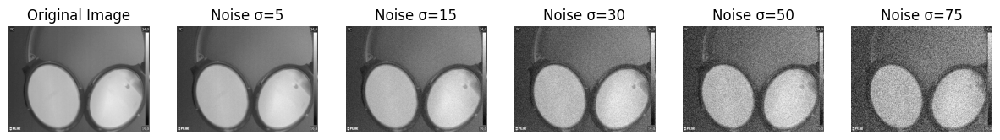

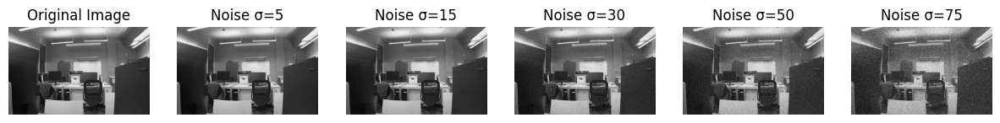

In [35]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def add_gaussian_noise(image_path, sigma_values):
    """
    Adds Gaussian noise to a given image for each sigma in sigma_values.

    :param image_path: Path to the image file.
    :param sigma_values: List of sigma values for Gaussian noise.
    :return: Dictionary of images with added noise for each sigma.
    """
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    noisy_images = {}

    for sigma in sigma_values:
        noise = np.random.normal(0, sigma, image.shape)
        noisy_image = np.clip(image + noise, 0, 255)
        noisy_images[sigma] = noisy_image.astype(np.uint8)

    return image, noisy_images

def show_images(original_image, noisy_images):
    """
    Displays the original image and its noisy counterparts.

    :param original_image: The original monochrome image.
    :param noisy_images: Dictionary of images with added noise for each sigma.
    """
    num_images = 1 + len(noisy_images)
    
    plt.figure(figsize=(15, 5))

    plt.subplot(1, num_images, 1)
    plt.imshow(original_image, cmap='gray')
    plt.title("Original Image")
    plt.axis('off')

    for i, (sigma, noisy_image) in enumerate(noisy_images.items(), start=2):
        plt.subplot(1, num_images, i)
        plt.imshow(noisy_image, cmap='gray')
        plt.title(f"Noise σ={sigma}")
        plt.axis('off')

    plt.show()

img1 = "images/Kamera_termowizyjna/10.jpg"
img2 = "images/Axis M1034_bezpieczenstwo/Kamera 4_2022-11-15_07_39_37_962.jpg"
sigma_val = [5, 15, 30, 50, 75]

gray_img1, add_noise_imgs1 = add_gaussian_noise(img1, sigma_val)
gray_img2, add_noise_imgs2 = add_gaussian_noise(img2, sigma_val)

show_images(gray_img1, add_noise_imgs1)
show_images(gray_img2, add_noise_imgs2)

Opisz swoje spostrzeżenia

# Wnioski

Analiza zaprezentowanych obrazów demonstruje efekt addytywnego szumu Gaussowskiego na dwa różne monochromatyczne obrazy. Poniżej przedstawiono spostrzeżenia i wnioski na podstawie obserwacji:

### Szum o poziomie σ=5
Przy najniższym poziomie szumu obrazy zachowują większość swojej ostrości i detali. Szum jest ledwo zauważalny, co sugeruje, że mała ilość szumu Gaussowskiego nie degraduje znacząco jakości obrazu.

### Szum o poziomie σ=15
Wraz ze wzrostem poziomu szumu ziarnistość staje się bardziej widoczna. Jednak główne cechy obu obrazów pozostają rozpoznawalne. Ten poziom szumu może być akceptowalny w scenariuszach, gdzie pewna utrata detali nie jest krytyczna.

### Szum o poziomie σ=30
Przy dalszym zwiększeniu poziomu szumu, obrazy zaczynają tracić drobniejsze detale. Krawędzie i tekstury zaczynają zlewać się z szumem, co może być problematyczne dla zadań przetwarzania obrazów, które polegają na tych detalach, takich jak wykrywanie krawędzi czy analiza tekstur.

### Szum o poziomie σ=50
Na tym poziomie szum jest już wyraźnie zaznaczony, a obrazy wyglądają na znacznie zdegradowane. Przydatność tych obrazów do szczegółowej analizy bez zastosowania technik redukcji szumu byłaby ograniczona.

### Szum o poziomie σ=75  
Najwyższy poziom szumu pokazuje znaczne pogorszenie jakości obrazu. Szum przytłacza większość detali, a oryginalna treść obrazów jest trudna do odczytania. Demonstruje to destrukcyjny efekt wysokiego poziomu szumu i podkreśla znaczenie zaawansowanych algorytmów redukcji szumu w przetwarzaniu obrazów.

Podsumowując, przedstawione obrazy skutecznie demonstrują wpływ różnych poziomów szumu Gaussowskiego na jakość obrazu. Jasne jest, że w miarę wzrostu odchylenia standardowego szumu, obrazy stają się mniej wyraźne i ich przydatność do szczegółowej analizy maleje. Ilustruje to kompromis pomiędzy poziomem szumu a użytecznością obrazu w praktycznych zastosowaniach. Techniki redukcji szumu stają się niezbędne przy radzeniu sobie z wyższymi poziomami szumu w celu odzyskania podstawowej zawartości obrazu.


### b) Szum Poissona   
  
  Szum Poissona jest otrzymywany przez zastąpienie wartości oryginalnej $f_{ij}$ przez wartość losową o rozkładzie Poissona.  

Należy dodać szum Poissona do 2 wybranych obrazów sla 5 różnych wartości parametru $λ$.

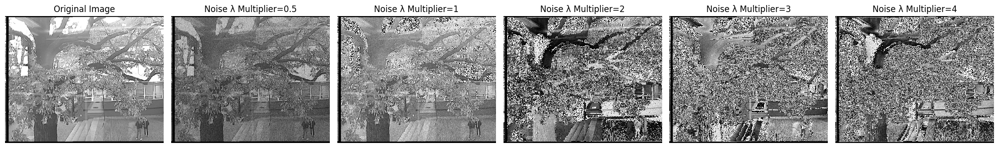

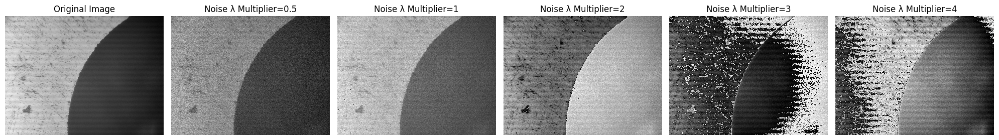

In [36]:
def add_poisson_noise(image_path, lambda_multipliers):
    """
    Adds Poisson noise to an image based on lambda multipliers.

    :param image_path: Path to the image file.
    :param lambda_multipliers: Multipliers to scale the lambda value for Poisson noise.
    :return: Dictionary of noisy images for each lambda multiplier.
    """
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    noisy_images = {}

    for multiplier in lambda_multipliers:
        noisy_image = np.random.poisson(image * multiplier).astype(np.uint8)
        noisy_images[multiplier] = noisy_image

    return image, noisy_images

def show_images_with_poisson_noise(original_image, noisy_images):
    """
    Displays the original image and its noisy counterparts with Poisson noise.

    :param original_image: The original grayscale image.
    :param noisy_images: Dictionary of images with added Poisson noise for each lambda multiplier.
    """
    num_images = 1 + len(noisy_images)
    plt.figure(figsize=(20, 10))

    plt.subplot(1, num_images, 1)
    plt.imshow(original_image, cmap='gray', interpolation='none')
    plt.title("Original Image")
    plt.axis('off')

    for i, (multiplier, noisy_image) in enumerate(noisy_images.items(), start=2):
        plt.subplot(1, num_images, i)
        plt.imshow(noisy_image, cmap='gray', interpolation='none')
        plt.title(f"Noise λ Multiplier={multiplier}")
        plt.axis('off')

    plt.tight_layout()
    plt.show()

img_path1 = "images\Samsung_ruch\capture_20221115_075431.jpg"
img_path2 = "images\mikroskop\image_4_2022-11-15.png"

lambda_multipliers = [0.5, 1, 2, 3, 4]

original_image1, pos_noise_imgs1 = add_poisson_noise(img_path1, lambda_multipliers)
show_images_with_poisson_noise(original_image1, pos_noise_imgs1)

original_image2, pos_noise_imgs2 = add_poisson_noise(img_path2, lambda_multipliers)
show_images_with_poisson_noise(original_image2, pos_noise_imgs2)


OPisz swoje spostrzeżenia

# Wnioski

Obserwacje dotyczące wpływu szumu Poissona na dwa obrazy przy różnych wartościach parametru \( \lambda \):

1. **Szum przy mnożniku \( $\lambda$ = 0.5 \)**: Obrazy wykazują mniejsze zaszumienie w porównaniu do wyższych wartości \( $\lambda$ \). Niższy mnożnik skutkuje mniejszą ilością szumu, co jest zgodne z oczekiwaniami dla rozkładu Poissona, gdzie wartość \( $\lambda$ \) jest średnią liczby zdarzeń (tutaj: intensywnością pikseli).

2. **Zwiększanie wartości \( $\lambda$ \)**: Wraz ze wzrostem wartości $\lambda$, poziom szumu staje się bardziej intensywny. Większe wartości \( $\lambda$ \) prowadzą do większego zróżnicowania wartości pikseli, co jest widoczne jako zwiększona ziarnistość na obrazie.

3. **Największe zaszumienie przy \( $\lambda$ = 4 \)**: Najwyższa wartość \( $\lambda$ \) powoduje znaczne zaszumienie obrazu, co może prowadzić do utraty detali i ogólnej jakości obrazu. Jest to szczególnie widoczne w obszarach obrazu o jednolitych tonach.

Wnioski z analizy pokazują, że szum Poissona ma silnie zależny od sygnału charakter, co oznacza, że wyższe wartości pikseli generują proporcjonalnie większy szum. Jest to istotna cecha szumu Poissona, która musi być brana pod uwagę przy projektowaniu systemów wizyjnych oraz w algorytmach przetwarzania obrazu i redukcji szumu.


### c) Szum Salt and Pepper. 
  
Szum w którym określona ilość pikselii jest zamieniana według rozkładu jednostajnego i ich wartość $f_{ij}$ jest zamieniana na 0 (czarny) lub biały (255) z prawdopodobieństwem $\frac{1}{2}$.  
  
Należy dodać szum Salt and Pepper do 2 wybranych obrazów dla 5%, 15%, 25%, 35% i 50% pikseli zamienionych na biały i/lub czarny.  


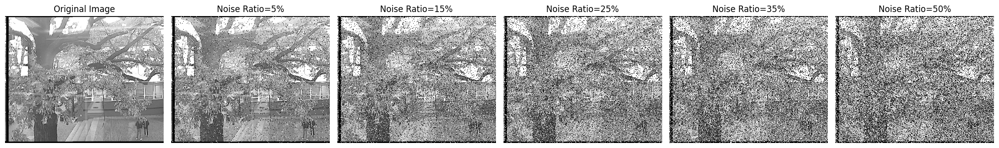

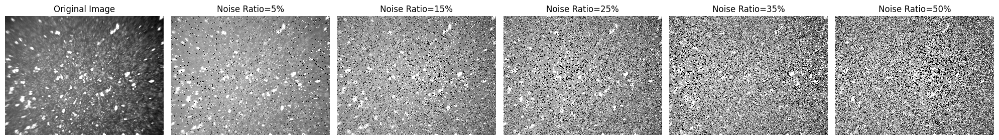

In [37]:
import random

def add_salt_and_pepper_noise(image_path, percentages):
    """
    Adds salt and pepper noise to an image for a list of percentages.

    :param image: The original grayscale image as a numpy array.
    :param percentages: List of percentages of the image pixels to be replaced with noise.
    :return: Dictionary of images with added salt and pepper noise for each percentage.
    """
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    noisy_images = {}
    rows, cols = image.shape
    num_pixels = rows * cols

    for percentage in percentages:
        noisy_image = image.copy()
        num_noisy_pixels = int(percentage * num_pixels / 100)

        for _ in range(num_noisy_pixels):
            x, y = random.randint(0, rows - 1), random.randint(0, cols - 1)
            
            if random.random() < 0.5:
                noisy_image[x, y] = 255
            else:
                noisy_image[x, y] = 0

        noisy_images[percentage] = noisy_image

    return image, noisy_images


def show_images_with_salt_and_pepper_noise(original_image, noisy_images):
    """
    Displays the original image and its noisy counterparts with salt and pepper noise.

    :param original_image: The original grayscale image.
    :param noisy_images: Dictionary of images with added salt and pepper noise for each ratio.
    """
    num_images = 1 + len(noisy_images)
    plt.figure(figsize=(20, 10))

    plt.subplot(1, num_images, 1)
    plt.imshow(original_image, cmap='gray', interpolation='none')
    plt.title("Original Image")
    plt.axis('off')

    for i, (ratio, noisy_image) in enumerate(noisy_images.items(), start=2):
        plt.subplot(1, num_images, i)
        plt.imshow(noisy_image, cmap='gray', interpolation='none')
        plt.title(f"Noise Ratio={ratio}%")
        plt.axis('off')

    plt.tight_layout()
    plt.show()


percentages = [5, 15, 25, 35, 50]
img_path1 = "images\Samsung_ruch\capture_20221115_075431.jpg"
img_path2 = "images\mikroskop\image_1_2022-11-15.png"

original_image, slt_noise_imgs1 = add_salt_and_pepper_noise(img_path1, percentages)
show_images_with_salt_and_pepper_noise(original_image, slt_noise_imgs1)

original_image2, slt_noise_imgs2 = add_salt_and_pepper_noise(img_path2, percentages)
show_images_with_salt_and_pepper_noise(original_image2, slt_noise_imgs2)


Opisz swoje spostrzeżenia

# Wnioski

Wnioski z analizy wpływu szumu "Salt and Pepper" na przykładowe obrazy przy różnych procentach zaszumienia:

1. **Szum przy 5% pikseli**: Zmiany są ledwo zauważalne, obraz pozostaje czytelny z zachowaniem większości detali.

2. **Szum przy 15% pikseli**: Szum staje się bardziej widoczny, ale główne elementy obrazu są nadal rozpoznawalne.

3. **Szum przy 25% pikseli**: Detale zaczynają być zatarte, a szum zaczyna dominować nad treścią obrazu, powodując trudności w rozróżnieniu drobnych szczegółów.

4. **Szum przy 35% pikseli**: Obraz jest znacznie zdegradowany, a szum ma silny wpływ na całość obrazu, znacznie obniżając jego jakość.

5. **Szum przy 50% pikseli**: Większość oryginalnej treści obrazu jest niewyraźna lub utracona, a szum "Salt and Pepper" staje się dominującym elementem obrazu.

Analiza pokazuje, że zwiększanie procentowej ilości zaszumionych pikseli prowadzi do stopniowej utraty informacji i jakości obrazu. Szczególnie przy wyższych wartościach szumu, takich jak 35% i 50%, obraz oryginalny staje się prawie nierozpoznawalny, co może stanowić wyzwanie dla algorytmów przetwarzania obrazów w celu odzyskania użytecznych informacji.


## Zadanie 2 - Filtrowanie 

Dla obrazów otrymanyh w zadaniu 1 oraz obrazu stworzonego na pierwszym laboratorium (obraz z liniami z dodanym szumem) wykonaj poniższe zadania. 
  
### a) Filtr Butterworth. 
  
Zastosuj filrt Butterworth do wszystkich obrazów

In [38]:
import numpy as np
from scipy.fftpack import fftshift, ifftshift, fft2, ifft2

def apply_butterworth_filter(image, cutoff_frequency, order):
    rows, cols = image.shape
    x = np.linspace(-0.5, 0.5, cols) * cols
    y = np.linspace(-0.5, 0.5, rows) * rows
    radius = np.sqrt((x**2)[np.newaxis] + (y**2)[:, np.newaxis])
    filter = 1 / (1 + (radius / cutoff_frequency)**(2*order))
    result = fftshift(fft2(image))
    result = result * filter
    result = ifft2(ifftshift(result))
    return np.abs(result)

def display_images_by_row(noised_images1, filtered_images1, noised_images2, filtered_images2):
    num_images = len(noised_images1)
    assert num_images == len(filtered_images1) == len(noised_images2) == len(filtered_images2), \
        "All dictionaries must have the same number of images"

    fig, axes = plt.subplots(4, num_images, figsize=(3 * num_images, 12))

    for i, key in enumerate(noised_images1.keys()):
        axes[0, i].imshow(noised_images1[key], cmap='gray', interpolation='none')
        axes[0, i].set_title(f'Noised Image {key} - 1')
        axes[0, i].axis('off')

        axes[1, i].imshow(filtered_images1[key], cmap='gray', interpolation='none')
        axes[1, i].set_title(f'Filtered Image {key} - 1')
        axes[1, i].axis('off')

    for i, key in enumerate(noised_images2.keys()):
        axes[2, i].imshow(noised_images2[key], cmap='gray', interpolation='none')
        axes[2, i].set_title(f'Noised Image {key} - 2')
        axes[2, i].axis('off')

        axes[3, i].imshow(filtered_images2[key], cmap='gray', interpolation='none')
        axes[3, i].set_title(f'Filtered Image {key} - 2')
        axes[3, i].axis('off')

    plt.tight_layout()
    plt.show()


cutoff_frequency = 30 
order = 2  

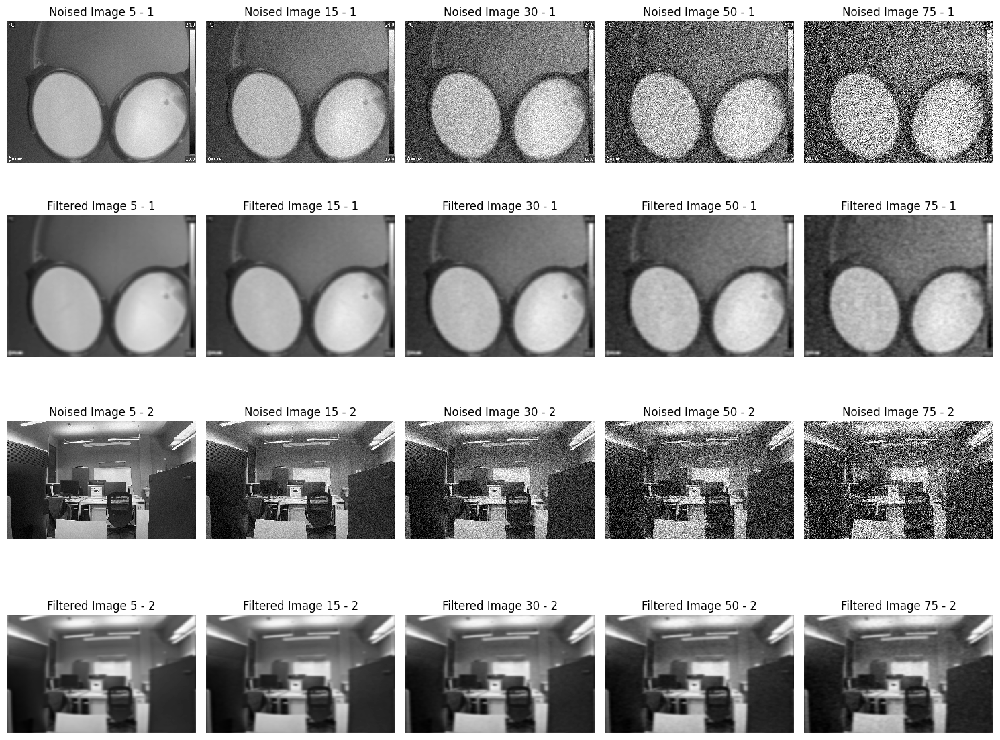

In [39]:
# Szum addytywny
filtered_images1 = {}
filtered_images2 = {}
for key, image in add_noise_imgs1.items():
    filtered_images1[key] = apply_butterworth_filter(image, cutoff_frequency, order)

for key, image in add_noise_imgs2.items():
    filtered_images2[key] = apply_butterworth_filter(image, cutoff_frequency, order)

display_images_by_row(add_noise_imgs1, filtered_images1, add_noise_imgs2, filtered_images2)

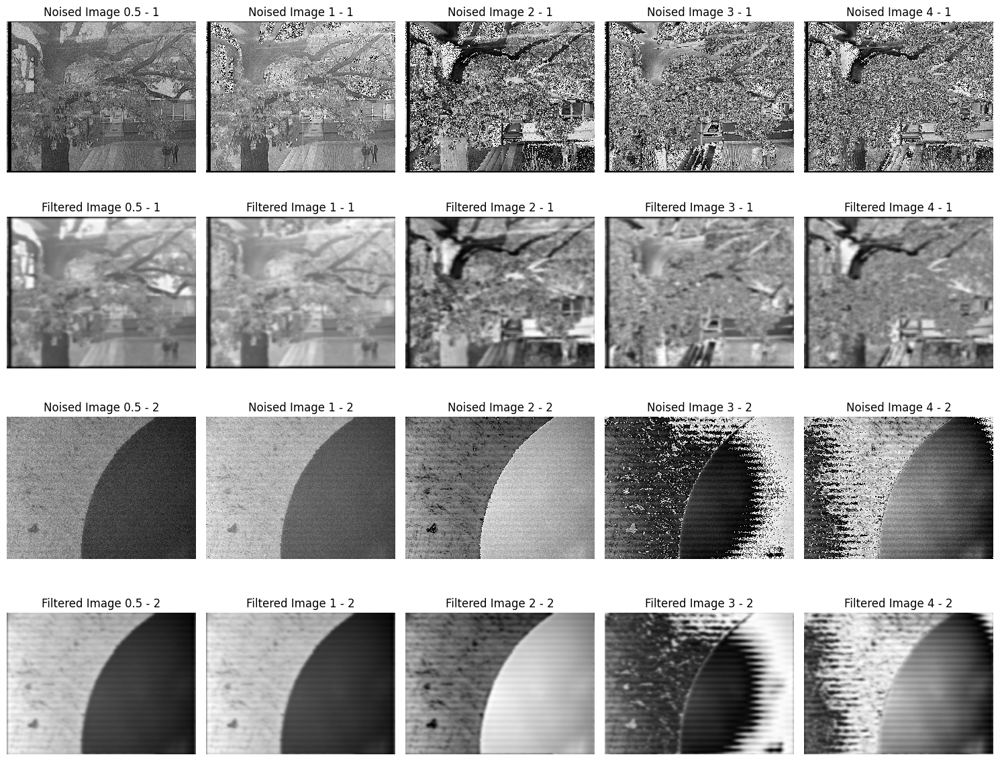

In [40]:
# Szum Poissona
filtered_images1 = {}
filtered_images2 = {}
for key, image in pos_noise_imgs1.items():
    filtered_images1[key] = apply_butterworth_filter(image, cutoff_frequency, order)

for key, image in pos_noise_imgs2.items():
    filtered_images2[key] = apply_butterworth_filter(image, cutoff_frequency, order)

display_images_by_row(pos_noise_imgs1, filtered_images1, pos_noise_imgs2, filtered_images2)

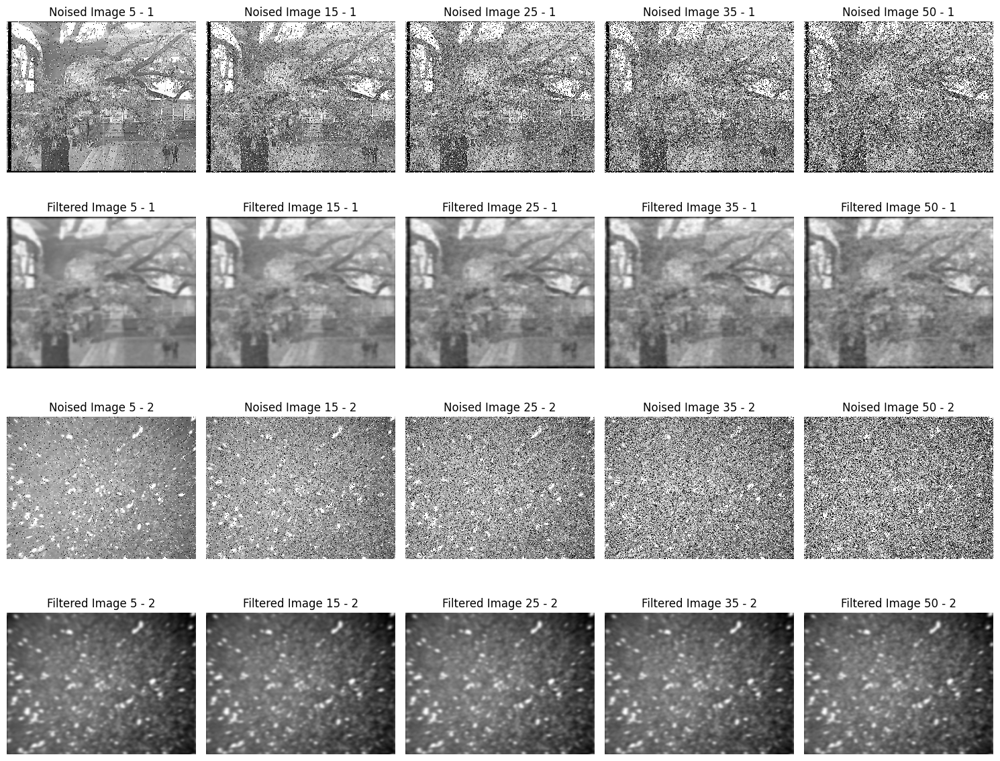

In [41]:
# Szum Salt_Pepper
filtered_images1 = {}
filtered_images2 = {}
for key, image in slt_noise_imgs1.items():
    filtered_images1[key] = apply_butterworth_filter(image, cutoff_frequency, order)

for key, image in slt_noise_imgs2.items():
    filtered_images2[key] = apply_butterworth_filter(image, cutoff_frequency, order)

display_images_by_row(slt_noise_imgs1, filtered_images1, slt_noise_imgs2, filtered_images2)

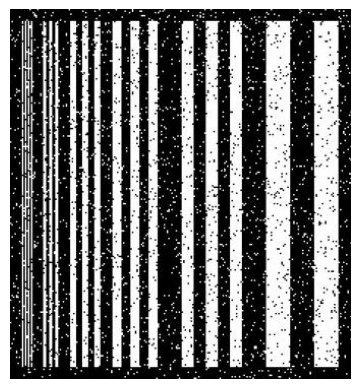

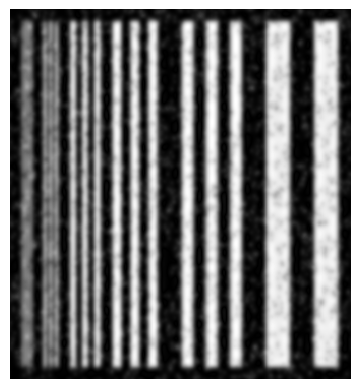

In [42]:
import matplotlib.image as mpimg

def display_image(image_path):
    img = mpimg.imread(image_path)
    plt.imshow(img)
    plt.axis('off')
    plt.show()


synthetic = "images\synthetic.jpg"
image = cv2.imread(synthetic, cv2.IMREAD_GRAYSCALE)
filetered_synthetic = apply_butterworth_filter(image, cutoff_frequency, order)
display_image(synthetic)

plt.imshow(filetered_synthetic, cmap='gray', interpolation='none')
plt.axis('off')
plt.show()

Opisz swoje spostrzeżenia

### Wnioski

Filtr Butterwortha jest popularnym wyborem w przetwarzaniu obrazów ze względu na jego płynną charakterystykę częstotliwościową. Oto główne wnioski dotyczące jego zastosowania:

1. **Gładkość Przejścia**: Filtr Butterwortha oferuje bardzo gładkie przejście od przepuszczanych do tłumionych częstotliwości, co jest korzystne w wielu zastosowaniach przetwarzania obrazów.

2. **Regulowana Ostrość Filtra**: Rząd filtra (`order`) umożliwia regulację stromości charakterystyki częstotliwościowej. Wyższy rząd skutkuje bardziej stromym przejściem od przepuszczania do tłumienia, ale może również prowadzić do większych zniekształceń w przestrzeni czasowej.

3. **Zastosowanie**: Filtr jest szczególnie użyteczny w redukcji szumów i rozmywaniu krawędzi, zachowując jednocześnie ogólną strukturę obrazu. Jest to istotne w analizie obrazów medycznych, obróbce zdjęć satelitarnych i innych zastosowaniach, gdzie zachowanie detali jest krytyczne.

4. **Ważność Wyboru Częstotliwości Granicznej**: Wybór częstotliwości granicznej (`cutoff_frequency`) ma kluczowe znaczenie, ponieważ determinuje, które częstotliwości będą przepuszczane, a które tłumione. Niewłaściwy wybór może prowadzić do utraty ważnych informacji lub niewystarczającej redukcji szumów.

Podsumowując, filtr Butterwortha jest potężnym narzędziem w przetwarzaniu obrazów, oferującym gładką charakterystykę częstotliwościową i szerokie możliwości zastosowania, przy odpowiednim doborze parametrów takich jak rząd filtra i częstotliwość graniczna.


### b) Filtr Gaussowski. 
  
Zastosuj filrt Gaussowski do wszystkich obrazów dla 3 różnych warotści $σ$

In [43]:
sigma_values = [5, 10, 15]

def apply_gaussian_filter(image, sigma):
    rows, cols = image.shape
    x = np.linspace(-0.5, 0.5, cols) * cols
    y = np.linspace(-0.5, 0.5, rows) * rows
    x, y = np.meshgrid(x, y)
    gaussian_kernel = np.exp(-(x**2 + y**2) / (2 * sigma**2))

    fshift = fftshift(fft2(image))
    fshift_filtered = fshift * gaussian_kernel
    result = ifft2(ifftshift(fshift_filtered))

    return np.abs(result)

def display_images_by_row_extended(noised_images, filtered_images_sigma1, filtered_images_sigma2, filtered_images_sigma3):
    num_images = len(noised_images)
    assert all(len(d) == num_images for d in [filtered_images_sigma1, filtered_images_sigma2, filtered_images_sigma3]), \
        "All dictionaries must have the same number of images"

    fig, axes = plt.subplots(4, num_images, figsize=(3 * num_images, 12))

    if num_images == 1:
        axes = axes.flatten()

    for i, (key, image) in enumerate(noised_images.items()):
        axes[0, i].imshow(image, cmap='gray', interpolation='none')
        axes[0, i].set_title(f'Original {key}')
        axes[0, i].axis('off')

    for row, (sigma_value, filtered_images) in enumerate([(sigma_values[0], filtered_images_sigma1), 
                                                          (sigma_values[1], filtered_images_sigma2), 
                                                          (sigma_values[2], filtered_images_sigma3)]):
        for i, (key, image) in enumerate(filtered_images.items()):
            axes[row + 1, i].imshow(image, cmap='gray', interpolation='none')
            axes[row + 1, i].set_title(f'Filtered σ={sigma_value}: {key}')
            axes[row + 1, i].axis('off')

    plt.tight_layout()
    plt.show()

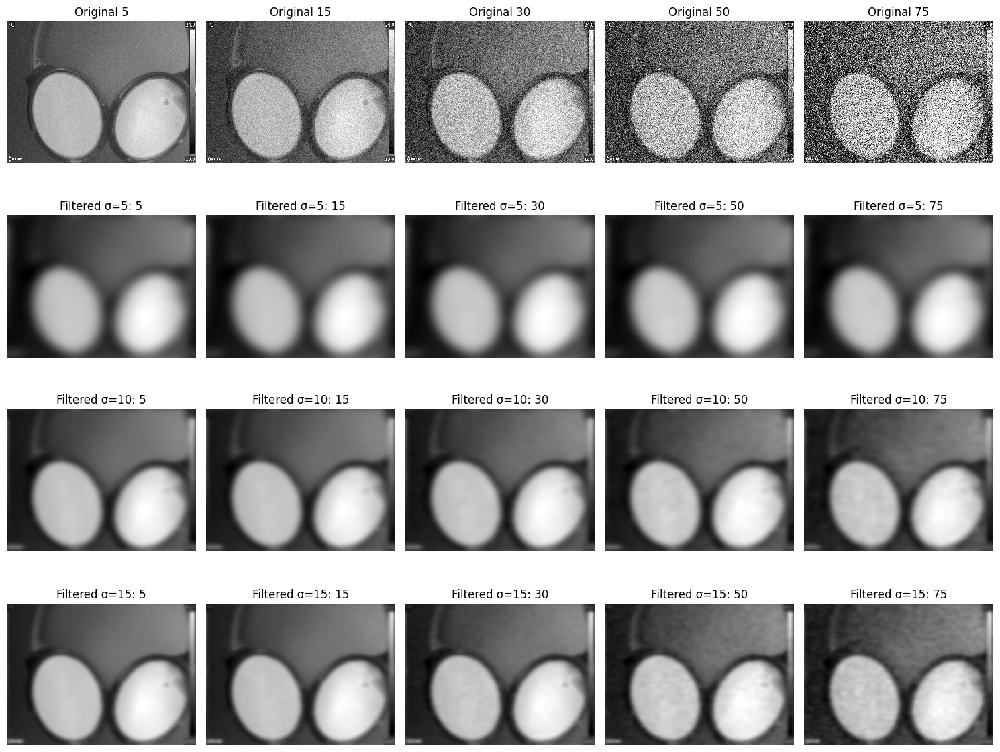

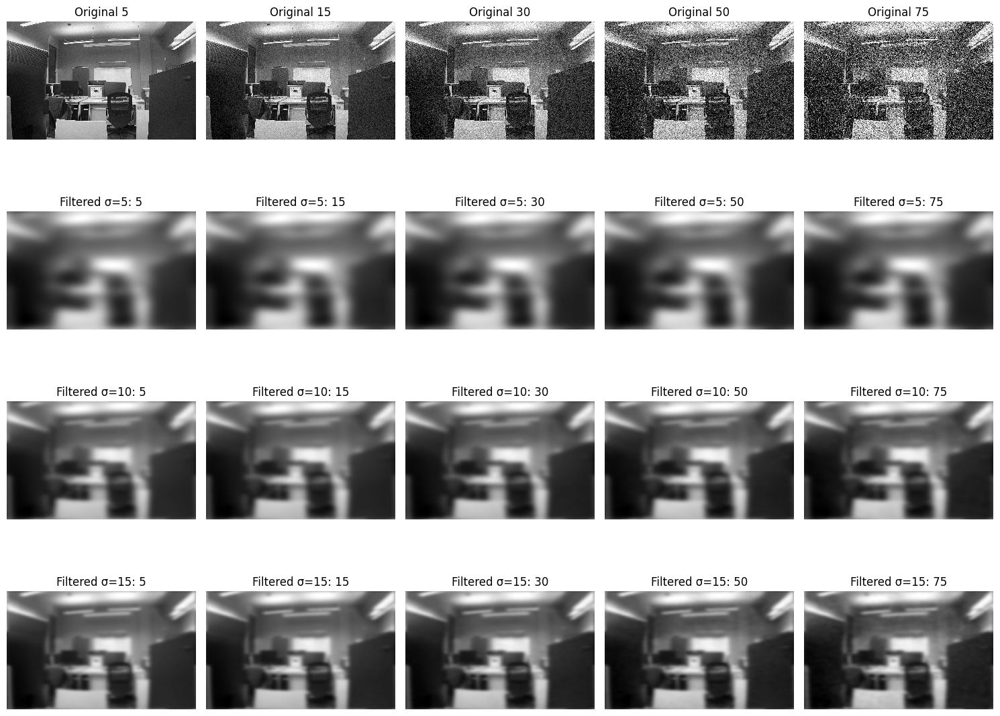

In [44]:
# szum addytywny
filtered_images1 = {sigma: {} for sigma in sigma_values}
filtered_images2 = {sigma: {} for sigma in sigma_values}

for sigma in sigma_values:
    for key, image in add_noise_imgs1.items():
        filtered_images1[sigma][key] = apply_gaussian_filter(image, sigma)
    for key, image in add_noise_imgs2.items():
        filtered_images2[sigma][key] = apply_gaussian_filter(image, sigma)

display_images_by_row_extended(add_noise_imgs1, filtered_images1[sigma_values[0]], filtered_images1[sigma_values[1]], filtered_images1[sigma_values[2]])
display_images_by_row_extended(add_noise_imgs2, filtered_images2[sigma_values[0]], filtered_images2[sigma_values[1]], filtered_images2[sigma_values[2]])

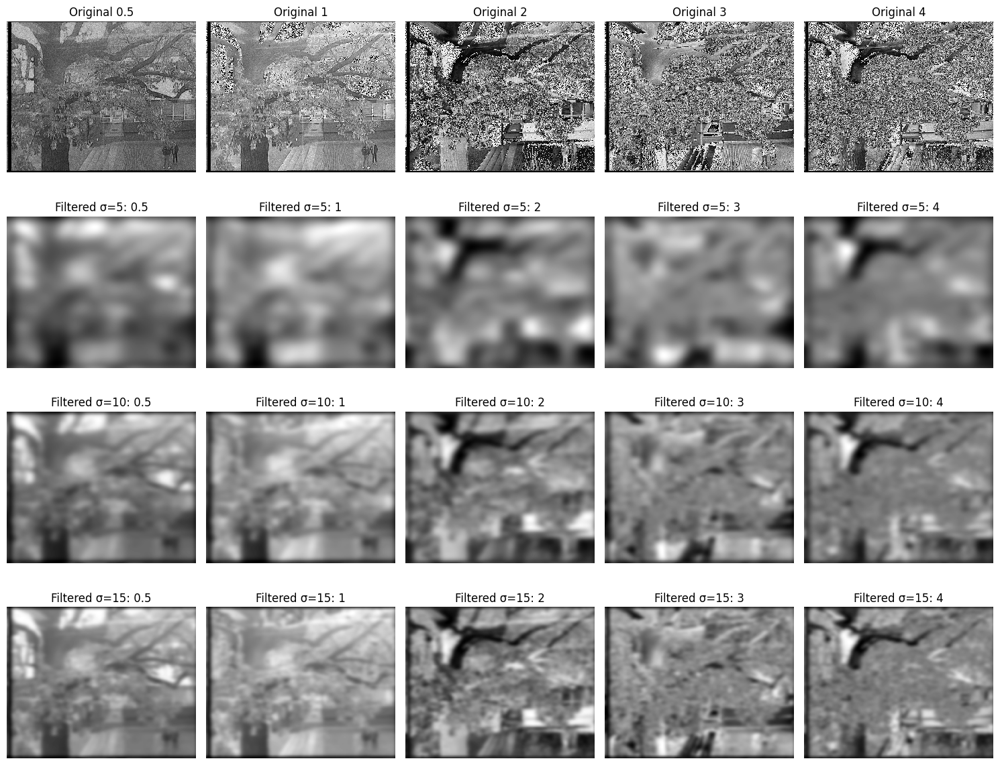

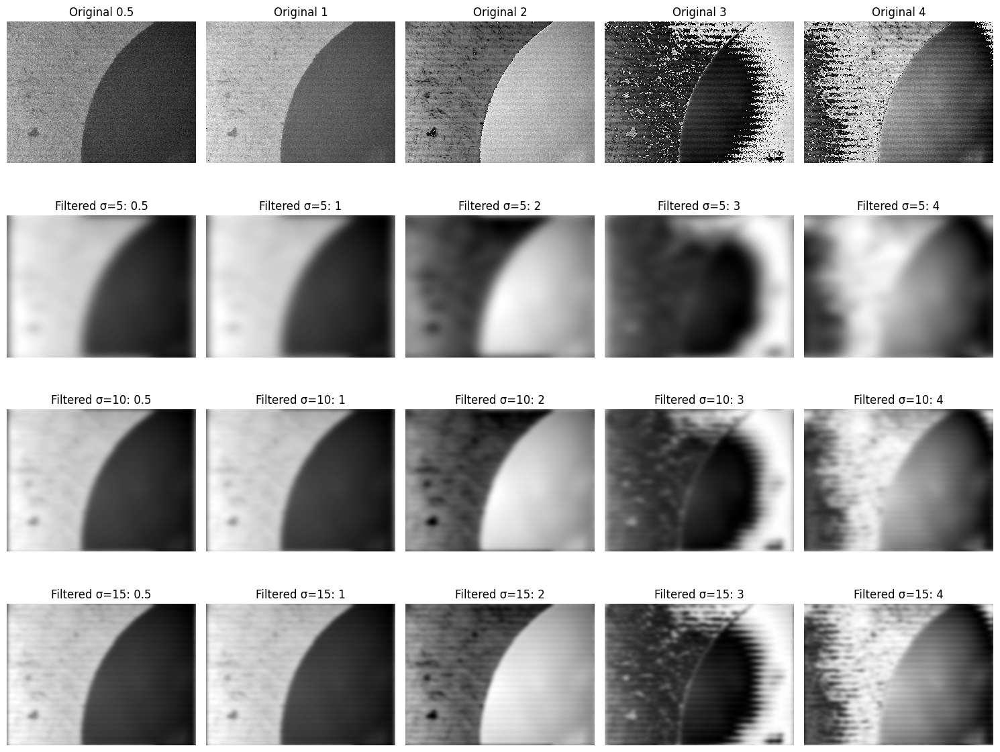

In [45]:
# szum poissona
filtered_images1 = {sigma: {} for sigma in sigma_values}
filtered_images2 = {sigma: {} for sigma in sigma_values}

for sigma in sigma_values:
    for key, image in pos_noise_imgs1.items():
        filtered_images1[sigma][key] = apply_gaussian_filter(image, sigma)
    for key, image in pos_noise_imgs2.items():
        filtered_images2[sigma][key] = apply_gaussian_filter(image, sigma)

display_images_by_row_extended(pos_noise_imgs1, filtered_images1[sigma_values[0]], filtered_images1[sigma_values[1]], filtered_images1[sigma_values[2]])
display_images_by_row_extended(pos_noise_imgs2, filtered_images2[sigma_values[0]], filtered_images2[sigma_values[1]], filtered_images2[sigma_values[2]])

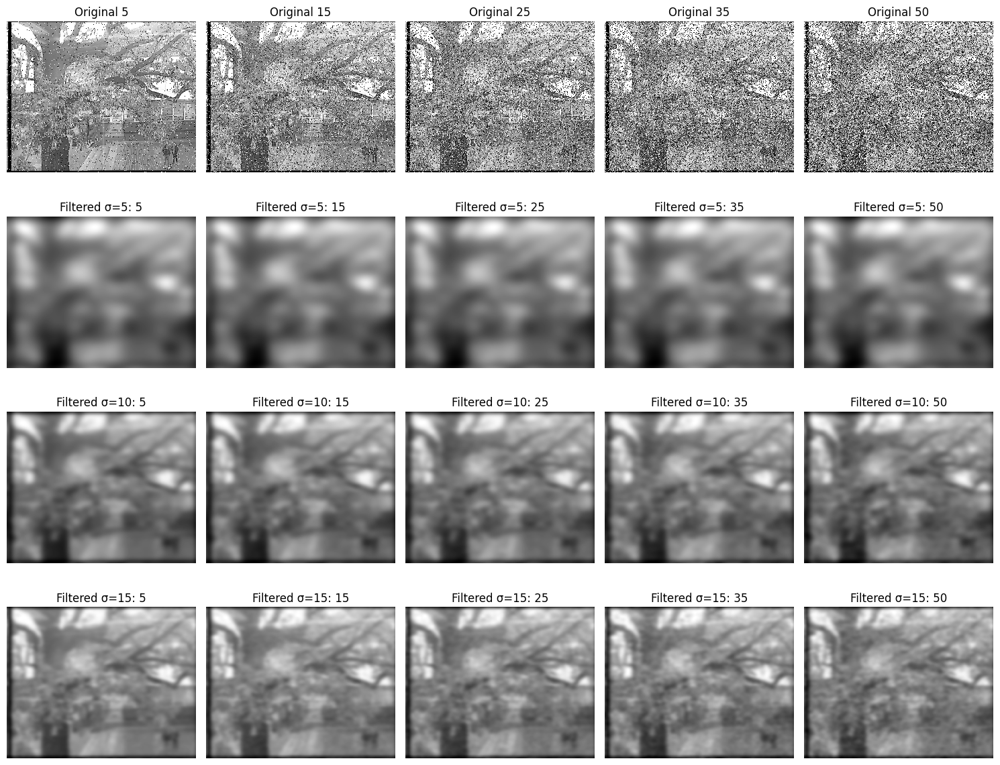

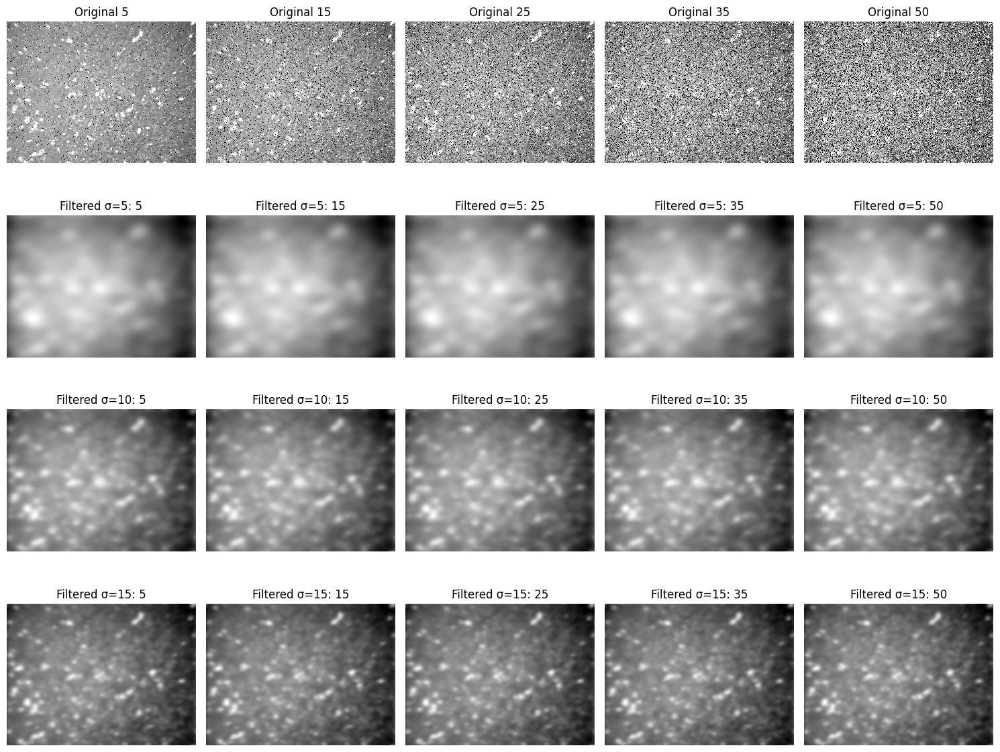

In [46]:
# szum salt_pepper
filtered_images1 = {sigma: {} for sigma in sigma_values}
filtered_images2 = {sigma: {} for sigma in sigma_values}

for sigma in sigma_values:
    for key, image in slt_noise_imgs1.items():
        filtered_images1[sigma][key] = apply_gaussian_filter(image, sigma)
    for key, image in slt_noise_imgs2.items():
        filtered_images2[sigma][key] = apply_gaussian_filter(image, sigma)

display_images_by_row_extended(slt_noise_imgs1, filtered_images1[sigma_values[0]], filtered_images1[sigma_values[1]], filtered_images1[sigma_values[2]])
display_images_by_row_extended(slt_noise_imgs2, filtered_images2[sigma_values[0]], filtered_images2[sigma_values[1]], filtered_images2[sigma_values[2]])

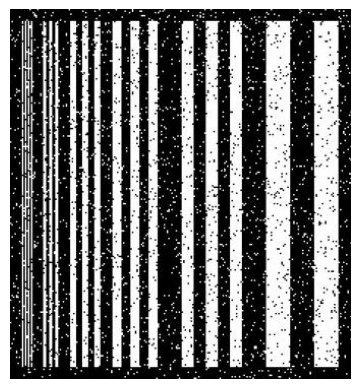

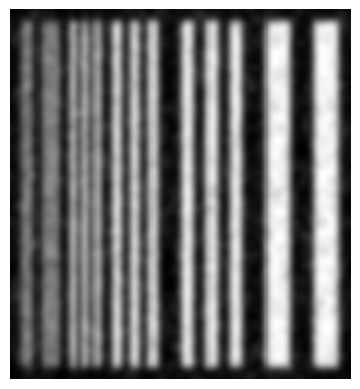

In [47]:
import matplotlib.image as mpimg

def display_image(image_path):
    img = mpimg.imread(image_path)
    plt.imshow(img)
    plt.axis('off')
    plt.show()


synthetic = "images\synthetic.jpg"
image = cv2.imread(synthetic, cv2.IMREAD_GRAYSCALE)
filetered_synthetic = apply_gaussian_filter(image, 15)
display_image(synthetic)

plt.imshow(filetered_synthetic, cmap='gray', interpolation='none')
plt.axis('off')
plt.show()

### c) Filtr Medianowy. 
  
Zastosuj filrt Medianowy do wszystkich obrazów dla 3 wartości okna (5x5, 11x11, 21x21)

In [48]:
def apply_median_filter(image, kernel_size):
    return cv2.medianBlur(image, kernel_size)

def display_images_by_row_median(noised_images, median_images_5x5, median_images_11x11, median_images_21x21):
    num_images = len(noised_images)
    assert all(len(d) == num_images for d in [median_images_5x5, median_images_11x11, median_images_21x21]), \
        "All dictionaries must have the same number of images"

    fig, axes = plt.subplots(4, num_images, figsize=(3 * num_images, 12))

    if num_images == 1:
        axes = axes.flatten()

    for i, (key, image) in enumerate(noised_images.items()):
        axes[0, i].imshow(image, cmap='gray', interpolation='none')
        axes[0, i].set_title(f'Original {key}')
        axes[0, i].axis('off')

    for row, median_images in enumerate([median_images_5x5, median_images_11x11, median_images_21x21]):
        for i, (key, image) in enumerate(median_images.items()):
            axes[row + 1, i].imshow(image, cmap='gray', interpolation='none')
            kernel_size = [5, 11, 21][row]
            axes[row + 1, i].set_title(f'Median {kernel_size}x{kernel_size}: {key}')
            axes[row + 1, i].axis('off')

    plt.tight_layout()
    plt.show()

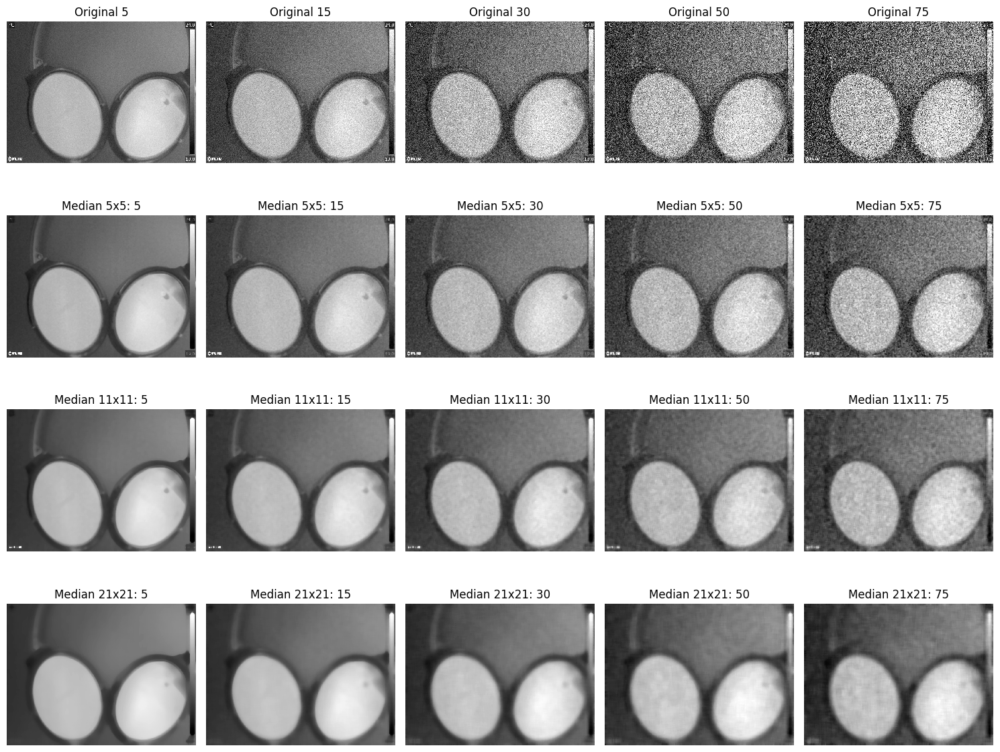

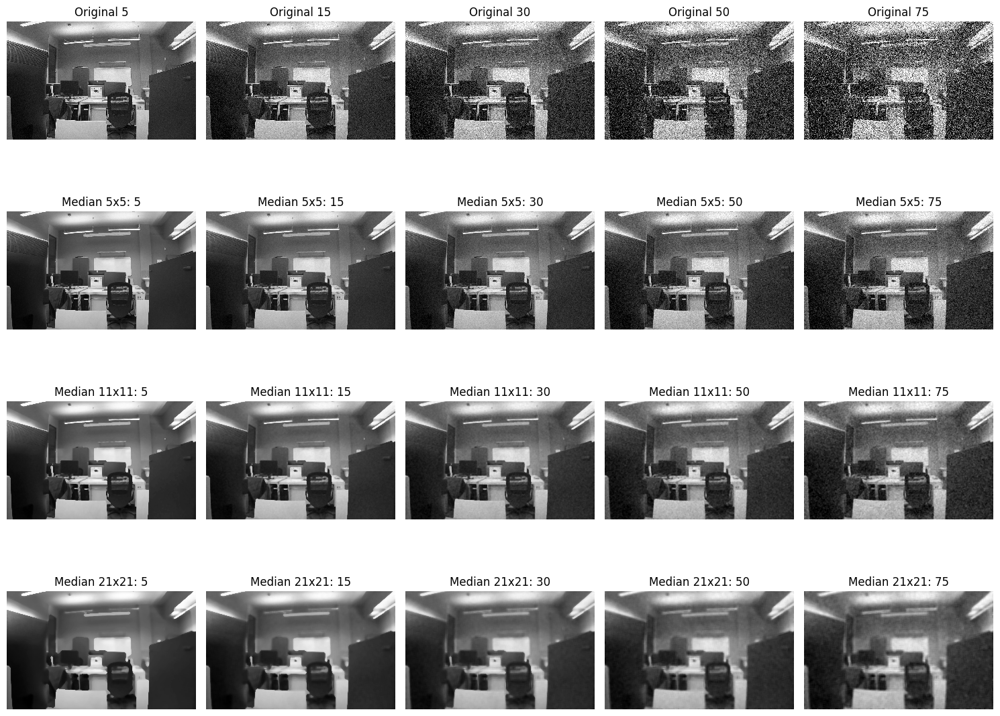

In [49]:
# szum addytywny
kernel_sizes = [5, 11, 21]

median_images_5x5 = {}
median_images_11x11 = {}
median_images_21x21 = {}

for key, image in add_noise_imgs1.items():
    median_images_5x5[key] = apply_median_filter(image, kernel_sizes[0])
    median_images_11x11[key] = apply_median_filter(image, kernel_sizes[1])
    median_images_21x21[key] = apply_median_filter(image, kernel_sizes[2])

display_images_by_row_median(add_noise_imgs1, median_images_5x5, median_images_11x11, median_images_21x21)

median_images_5x5 = {}
median_images_11x11 = {}
median_images_21x21 = {}

for key, image in add_noise_imgs2.items():
    median_images_5x5[key] = apply_median_filter(image, kernel_sizes[0])
    median_images_11x11[key] = apply_median_filter(image, kernel_sizes[1])
    median_images_21x21[key] = apply_median_filter(image, kernel_sizes[2])

display_images_by_row_median(add_noise_imgs2, median_images_5x5, median_images_11x11, median_images_21x21)


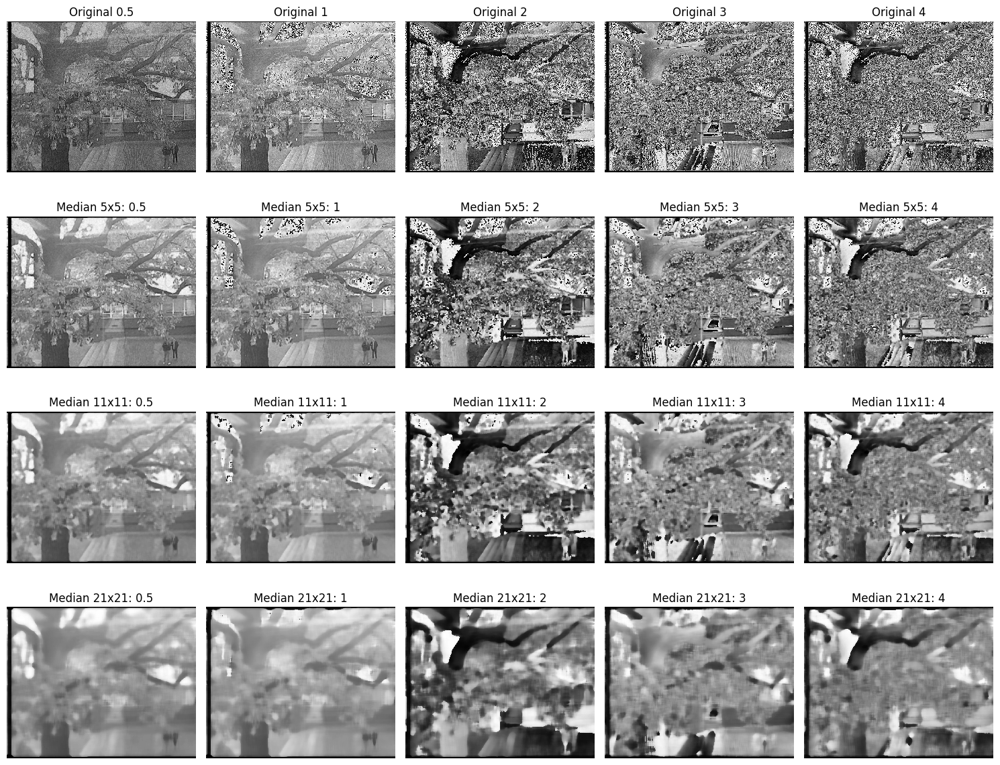

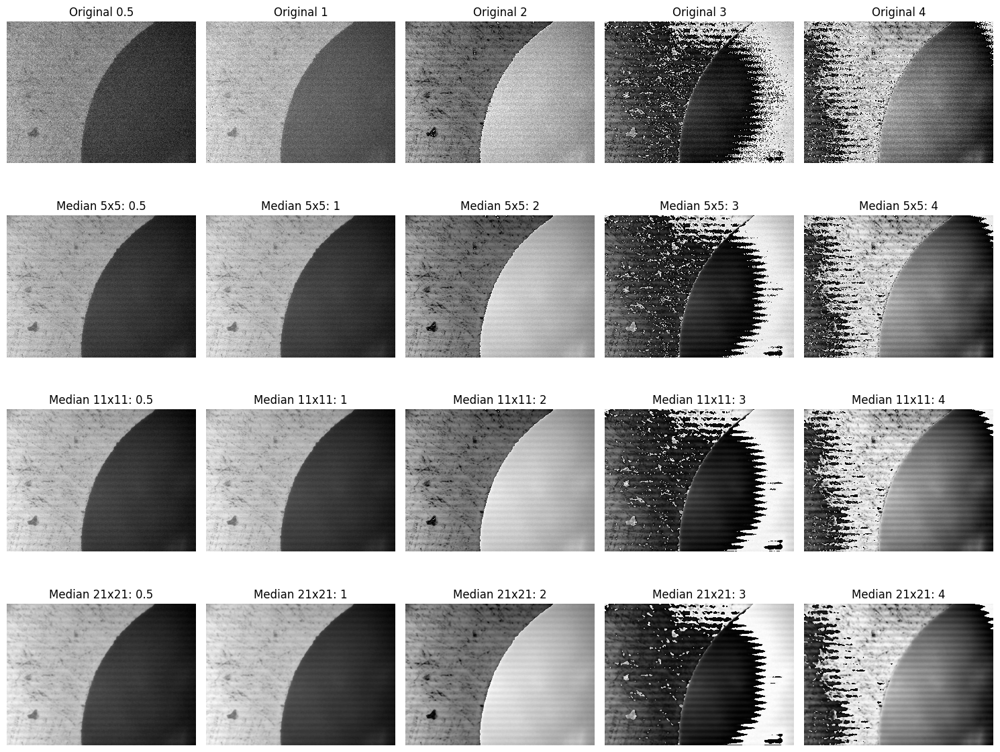

In [50]:
# szum poissona
kernel_sizes = [5, 11, 21]

median_images_5x5 = {}
median_images_11x11 = {}
median_images_21x21 = {}

for key, image in pos_noise_imgs1.items():
    median_images_5x5[key] = apply_median_filter(image, kernel_sizes[0])
    median_images_11x11[key] = apply_median_filter(image, kernel_sizes[1])
    median_images_21x21[key] = apply_median_filter(image, kernel_sizes[2])

display_images_by_row_median(pos_noise_imgs1, median_images_5x5, median_images_11x11, median_images_21x21)

median_images_5x5 = {}
median_images_11x11 = {}
median_images_21x21 = {}

for key, image in pos_noise_imgs2.items():
    median_images_5x5[key] = apply_median_filter(image, kernel_sizes[0])
    median_images_11x11[key] = apply_median_filter(image, kernel_sizes[1])
    median_images_21x21[key] = apply_median_filter(image, kernel_sizes[2])

display_images_by_row_median(pos_noise_imgs2, median_images_5x5, median_images_11x11, median_images_21x21)

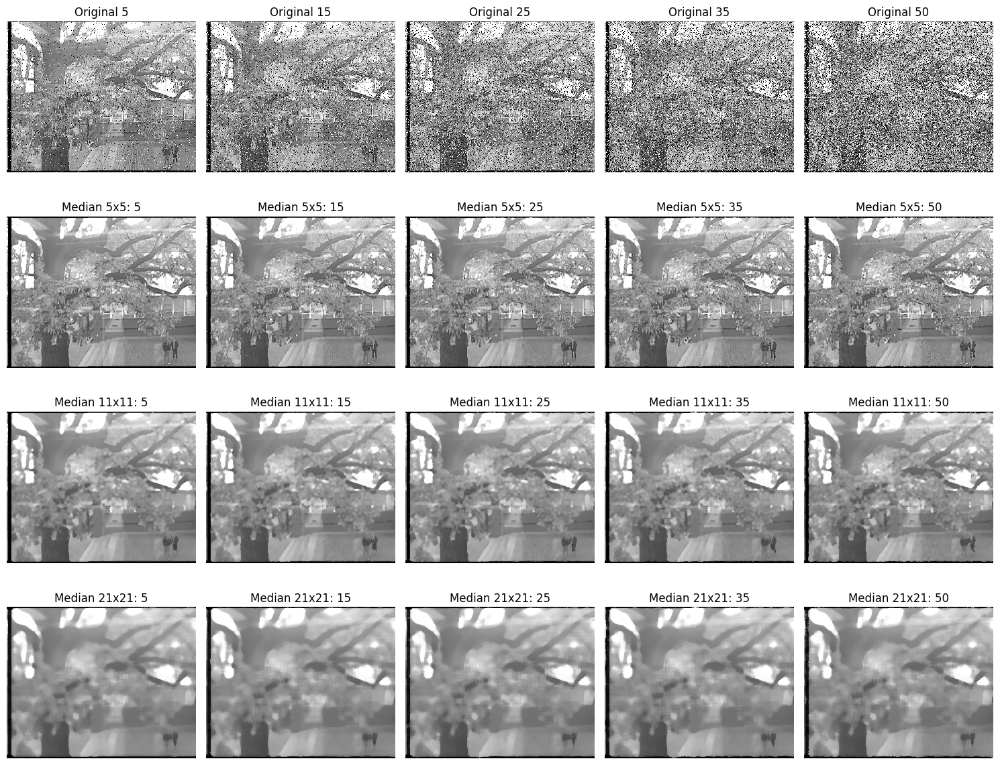

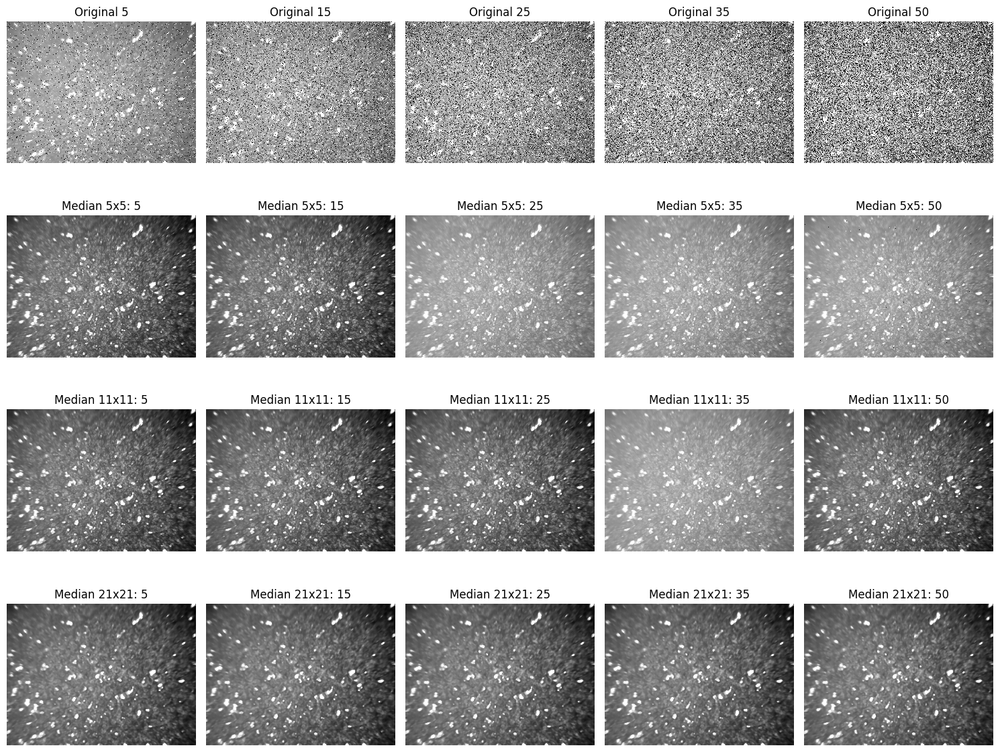

In [51]:
# szum salt_pepper
kernel_sizes = [5, 11, 21]

median_images_5x5 = {}
median_images_11x11 = {}
median_images_21x21 = {}

for key, image in slt_noise_imgs1.items():
    median_images_5x5[key] = apply_median_filter(image, kernel_sizes[0])
    median_images_11x11[key] = apply_median_filter(image, kernel_sizes[1])
    median_images_21x21[key] = apply_median_filter(image, kernel_sizes[2])

display_images_by_row_median(slt_noise_imgs1, median_images_5x5, median_images_11x11, median_images_21x21)

median_images_5x5 = {}
median_images_11x11 = {}
median_images_21x21 = {}

for key, image in slt_noise_imgs2.items():
    median_images_5x5[key] = apply_median_filter(image, kernel_sizes[0])
    median_images_11x11[key] = apply_median_filter(image, kernel_sizes[1])
    median_images_21x21[key] = apply_median_filter(image, kernel_sizes[2])

display_images_by_row_median(slt_noise_imgs2, median_images_5x5, median_images_11x11, median_images_21x21)

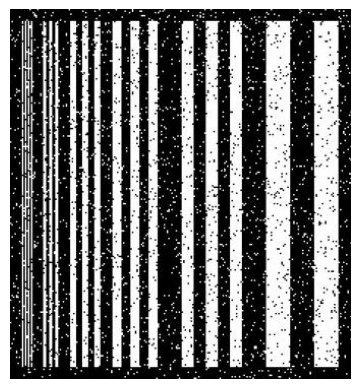

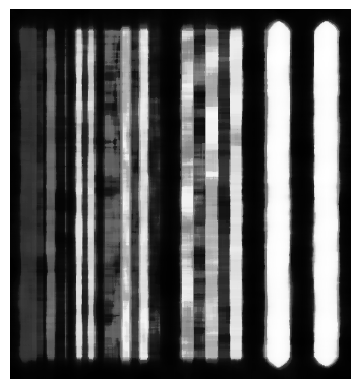

In [56]:
import matplotlib.image as mpimg

def display_image(image_path):
    img = mpimg.imread(image_path)
    plt.imshow(img)
    plt.axis('off')
    plt.show()


synthetic = "images\synthetic.jpg"
image = cv2.imread(synthetic, cv2.IMREAD_GRAYSCALE)
filetered_synthetic = apply_median_filter(image, 21)
display_image(synthetic)

plt.imshow(filetered_synthetic, cmap='gray', interpolation='none')
plt.axis('off')
plt.show()

Opisz swoje spostrzeżenia. Czy wszystkie filtry tak samo zachowują krawęzie? 

Analizując działanie trzech różnych typów filtrów - filtra Butterwortha, filtra gaussowskiego oraz filtra medianowego - na obrazach z szumem, można zauważyć, że każdy z nich ma unikalne właściwości wpływające na jakość obrazu. Filtr Butterwortha, działający w domenie częstotliwości, skupia się na redukcji częstotliwości poza ustalonym zakresem, oferując gładkie przejście między przepuszczanymi a tłumionymi częstotliwościami, lecz może nie być tak efektywny w zachowaniu ostrych krawędzi. Z kolei filtr Gaussowski, będący filtrem przestrzennym, stosuje ważone uśrednianie pikseli, skutecznie redukując szumy, ale potencjalnie prowadząc do rozmycia krawędzi. W przeciwieństwie do nich, filtr medianowy, zastępujący wartość piksela medianą sąsiednich pikseli, wykazuje się wyjątkową zdolnością do zachowania krawędzi, będąc jednocześnie efektywnym w redukcji szumów impulsowych, takich jak „sól i pieprz”. W rezultacie, podczas gdy filtry Butterwortha i Gaussowskiego mogą być preferowane dla ogólnego wygładzania obrazu i redukcji szumów o charakterze gaussowskim, filtr medianowy jest lepszym wyborem w scenariuszach, gdzie kluczowe jest zachowanie krawędzi, szczególnie w obecności silnych szumów impulsowych.


## Zadanie 3 - Wyznaczanie krawędzi

Trzy dowolne obrazy pozyskane w trakcie laboratorium 2 zamień na obrazy monochromatyczne, a następnie wykonaj poniższe polecenia. 

### a) Detekcja krawędzi metodą Sobela. 
  
Zastosuj filtr Sobela do wybranych obrazów

In [52]:
def apply_sobel_filter(image_path):
    image = cv2.imread(image_path)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)
    
    magnitude = np.sqrt(sobelx**2 + sobely**2)
    sobel_combined = np.uint8(np.absolute(magnitude))

    return sobel_combined

### b) Detekcja krawędzi metodą Laplace'a. 
  
Zastosuj filtr Laplace'a do wybranych obrazów

In [53]:
def apply_laplace_filter(image_path):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    laplacian = cv2.Laplacian(image, cv2.CV_64F)
    return np.uint8(np.absolute(laplacian))

### c) Detekcja krawędzi metodą Canny'ego. 
  
Zastosuj filtr Canne'ego do wybranych obrazów

In [54]:
def apply_canny_filter(image_path, low_threshold, high_threshold):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE) 
    canny = cv2.Canny(image, low_threshold, high_threshold)
    return canny

images\Kamera_termowizyjna\40.jpg


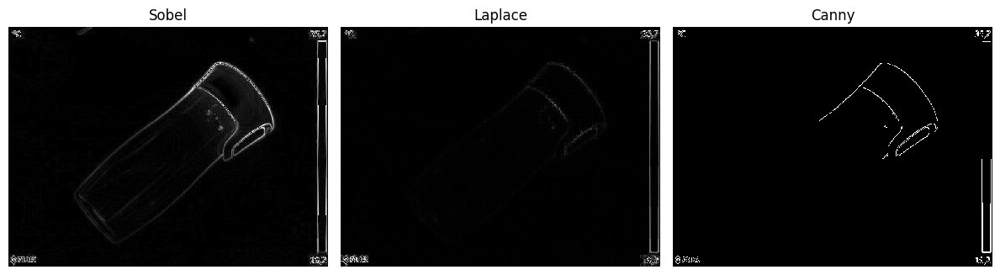

images\Kamera_HDR\pusta.jpg


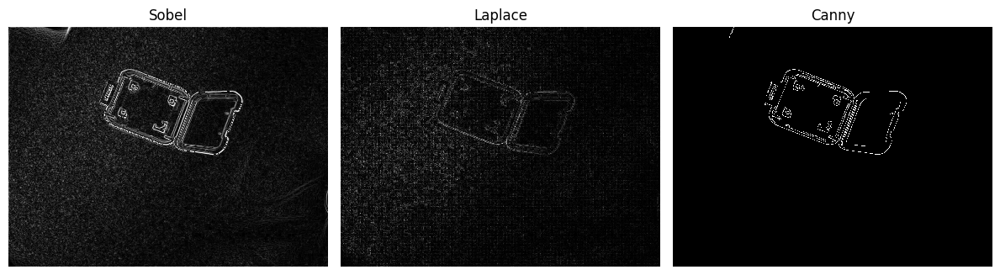

images\Axis M1034_bezpieczenstwo\Kamera 4_2022-11-15_07_40_15_506.jpg


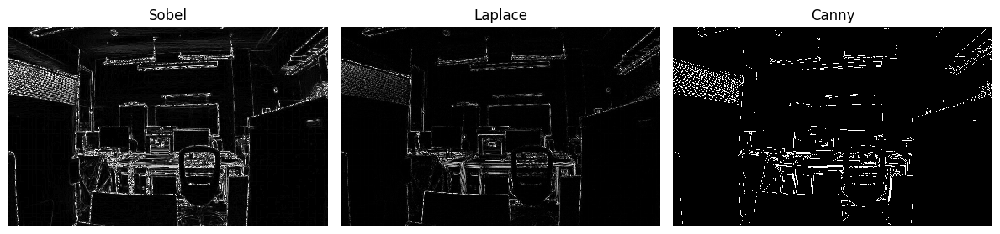

In [55]:
# wizualizacja

def display_edge_detection_methods(image_path):
    sobel_image = apply_sobel_filter(image_path)
    laplace_image = apply_laplace_filter(image_path)
    canny_image = apply_canny_filter(image_path, 100, 200)

    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(sobel_image, cmap='gray', interpolation='none')
    plt.title('Sobel')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(laplace_image, cmap='gray', interpolation='none')
    plt.title('Laplace')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(canny_image, cmap='gray', interpolation='none')
    plt.title('Canny')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

img_paths = [
    r"images\Kamera_termowizyjna\40.jpg",
    r"images\Kamera_HDR\pusta.jpg",
    r"images\Axis M1034_bezpieczenstwo\Kamera 4_2022-11-15_07_40_15_506.jpg"
]

for path in img_paths:
    print(path)
    display_edge_detection_methods(path)

Opisz swoje spostrzeżenia po porównaniu 3 metod wyznaczania krawędzi.

W zależności od zdjęcia różne metody wydają się odpowiednie. W przypadku pierwszego zdjęcia najlepsza okazała się metoda Sobela, ponieważ wykryła również mniej wyraźne krawędzie. W przypadku zdjęcia drugiego, najlepszą metodą była metoda Cannyego, ponieważ posiada najmniej szumów na zdjęciu (poza wykrytymi krawędziami). W przypadku zdjęcia trzeciego, również metoda Sobela okazała się najdokładniejsza